<a href="https://colab.research.google.com/github/bu4er88/Semantic_segmentation/blob/main/Semantic_Segmentaion_Pet_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [23]:
from google.colab import files
files.upload()  # upload kaggle.json file

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"yauhenikavaliou","key":"5deb9439ecec8ef014fc31d185dcd4d4"}'}

In [24]:
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!kaggle datasets download -d carlolepelaars/camseq-semantic-segmentation

camseq-semantic-segmentation.zip: Skipping, found more recently modified local copy (use --force to force download)


In [25]:
!ls

 camseq-semantic-segmentation.zip  'kaggle (1).json'   sample_data
 data				    kaggle.json


In [26]:
!unzip camseq-semantic-segmentation.zip -d /content/data/

Archive:  camseq-semantic-segmentation.zip
replace /content/data/0016E5_07959.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [27]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import PIL
import PIL.Image as Image
import os
import io
import time
import cv2
import tensorflow_hub as hub

import matplotlib
import random

import warnings
warnings.filterwarnings('ignore')

matplotlib.pyplot.rcParams['figure.figsize'] = (10,5)

#**Dataset**

```
https://www.kaggle.com/carlolepelaars/camseq-semantic-segmentation?select=0016E5_07963_L.png
```

In [28]:
color_codes = {
    'Animal': [64, 128, 64],
    'Archway': [192, 0, 128],
    'Bicyclist': [0, 128, 192],
    #'Bridge': [0, 128, 64],
    'Building': [128, 0, 0],
    'Car': [64, 0, 128],
    'CartLuggagePram': [64, 0, 192],
    'Child': [192, 128, 64], 
    'Column_Pole': [192, 192, 128],
    'Fence': [64, 64, 128],
    'LaneMkgsDriv': [128, 0, 192],
    #'LaneMkgsNonDriv': [192, 0, 64],
    'Misc_Text': [128, 128, 64],
    #'MotorcycleScooter': [192, 0, 192],
    'OtherMoving': [128, 64, 64],
    #'ParkingBlock': [64, 192, 128],
    'Pedestrian': [64, 64, 0],
    'Road': [128, 64, 128],
    #'RoadShoulder': [128, 128, 192],
    'Sidewalk': [0, 0, 192],
    'SignSymbol': [192, 128, 128],
    'Sky': [128, 128, 128],
    #'SUVPickupTruck': [64, 128, 192],
    #'TrafficCone': [0, 0, 64],
    'TrafficLight': [0, 64, 64],
    #'Train': [192, 64, 128],
    'Tree': [128, 128, 0],
    'Truck_Bus': [192, 128, 192],
    #'Tunnel': [64, 0, 64],
    'VegetationMisc': [192, 192, 0],
    'Void': [0, 0, 0],
    'Wall': [64, 192, 0]
}

In [29]:
NEW_SIZE = (256, 256)
PATH = '/content/data'
N_CLASSES = len(color_codes.keys())

def arrays_from_single_folder(path=PATH, new_size=NEW_SIZE):  
    images = []
    masks = []
    filenames = os.listdir(PATH)
    filenames.sort()
    for filename in filenames:
        path_to_img = os.path.join(path, filename)
        try :
            if filename.split('.')[0][-2:] == '_L':
                img = cv2.imread(path_to_img)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, new_size) 
                masks.append(img)
            else:
                img = cv2.imread(path_to_img)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, new_size) 
                img = img / 255.0
                images.append(img)
        except:
            continue
    return images, masks

In [30]:
def get_mask_channels(mask, color_codes):
    n_channels = len(color_codes.keys())  # N_CLASSES
    mask_channels = np.zeros((mask.shape[0], mask.shape[1], n_channels), 
                             dtype=np.float32)
    for i, cls in enumerate(color_codes.keys()):
        color = color_codes[cls]
        sub_mask = np.all(mask==color, axis=-1) * i
        mask_channels[:, :, i] = sub_mask
    return mask_channels

def get_masks_one_hot(mask, color_codes):
    n_channels = len(color_codes.keys())  # N_CLASSES
    mask_channels = np.zeros((mask.shape[0], mask.shape[1], n_channels), 
                             dtype=np.float32)
    for i, cls in enumerate(color_codes.keys()):
        color = color_codes[cls]
        sub_mask = np.all(mask==color, axis=-1) * 1
        mask_channels[:, :, i] = sub_mask
    return mask_channels

In [31]:
images, masks = arrays_from_single_folder(PATH, NEW_SIZE)

masks_channels = [get_mask_channels(mask, color_codes) for mask in masks]

masks_one_hot = [get_masks_one_hot(mask, color_codes) for mask in masks]

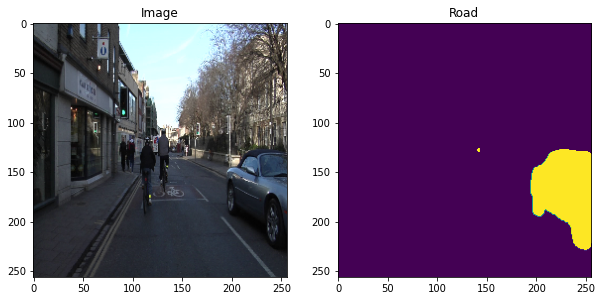

In [32]:
i = 45
plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.imshow(images[i])
plt.title('Image')
plt.subplot(1, 2, 2)
plt.imshow(masks_one_hot[i][:,:,4])
plt.title('Road')
plt.show()

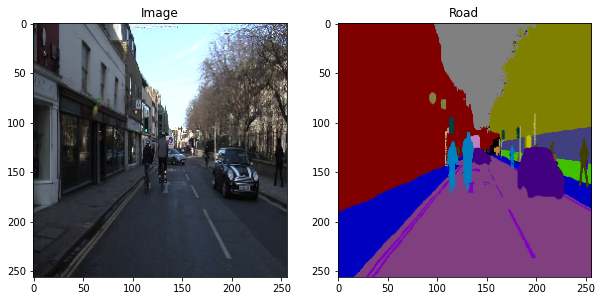

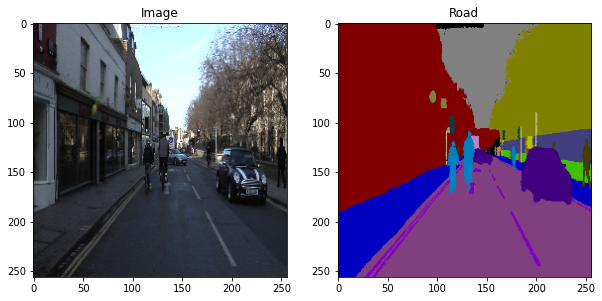

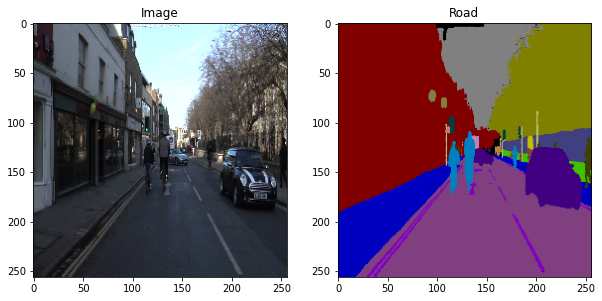

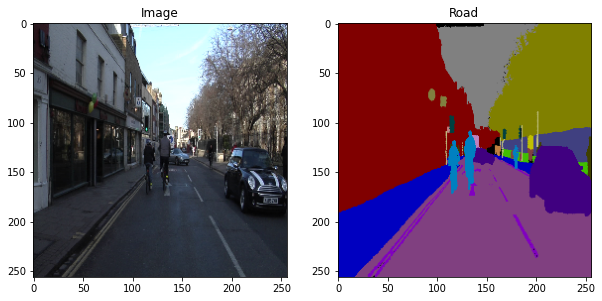

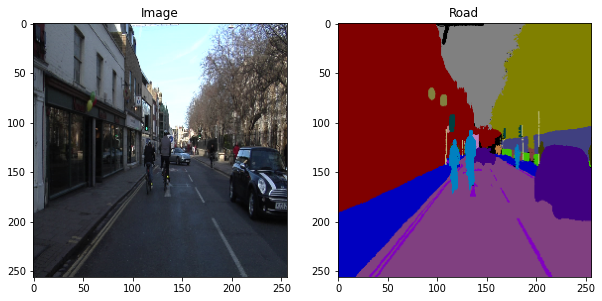

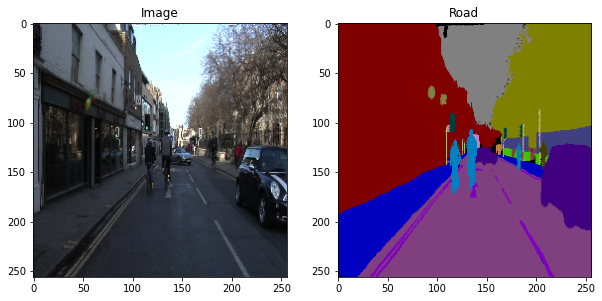

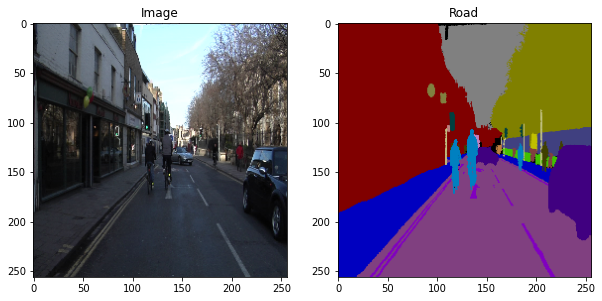

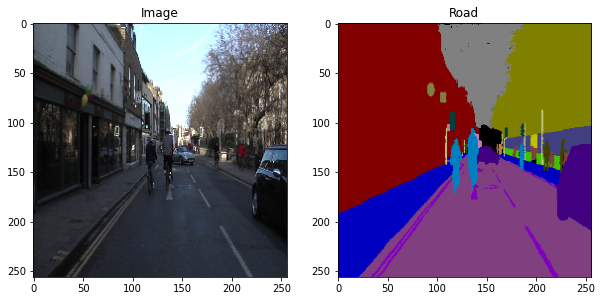

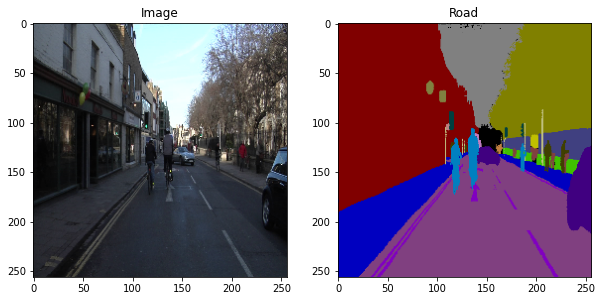

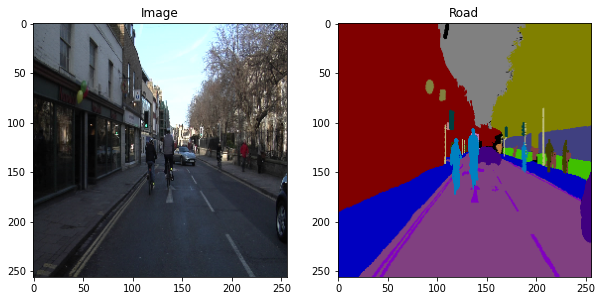

In [33]:
for i in range(10):
    plt.figure(figsize=(10,5))
    plt.subplot(1, 2, 1)
    plt.imshow(images[i])
    plt.title('Image')
    plt.subplot(1, 2, 2)
    plt.imshow(masks[i])
    plt.title('Road')
    plt.show()

In [34]:
# classes 3, 11, 13, 15, 25, 28 are absent in the dataset (those classes were commented in 'color_codes')
np.unique(masks_channels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22.], dtype=float32)

In [35]:
# check masks_one_hot variable (in must consist of 0 and 1)
np.unique(masks_one_hot)

array([0., 1.], dtype=float32)

In [36]:
from sklearn.utils import class_weight

# check data balance and create weithts in case of disbalance
class_weights = class_weight.compute_class_weight('balanced',
                                                  np.unique(masks_channels),
                                                  np.array(masks_channels).reshape(-1))      
# get class names and weights
dict_of_classes = {}
for i, j in enumerate(color_codes.keys()):
    try:
        dict_of_classes[j] = class_weights[i]
    except:
       continue
# look at classes and their weights
dict_of_classes

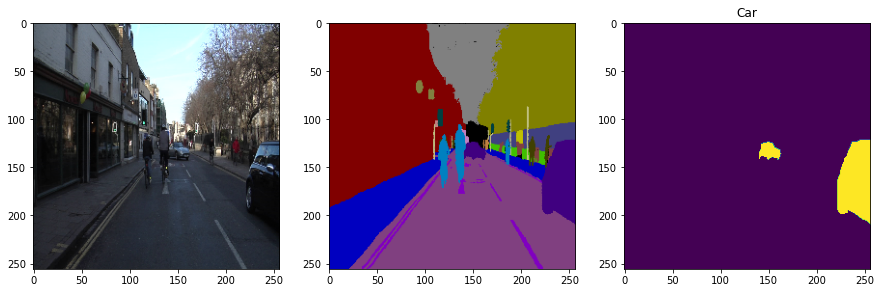

In [37]:
# look at the picture, it's mask and one of the the picture's one-hot-mask layer
plt.figure(figsize=(15, 10))
plt.subplot(1,3,1)
plt.imshow(images[7])
plt.subplot(1,3,2)
plt.imshow(masks[7])
plt.subplot(1,3,3)
plt.imshow(masks_one_hot[7][:, :, 4]) ## cars
plt.title('Car')
plt.show()

In [38]:
from sklearn.model_selection import train_test_split

# split data on train/val/test sets
x_train, x_valtest, y_train, y_valtest = train_test_split(
    images, masks_one_hot, test_size=0.2, random_state=42, shuffle=True)
x_val, x_test, y_val, y_test = train_test_split(
    x_valtest, y_valtest, test_size=0.2, random_state=42, shuffle=False)

len(x_train), len(y_train), len(x_val), len(y_val), len(x_test), len(y_test)

(80, 80, 16, 16, 5, 5)

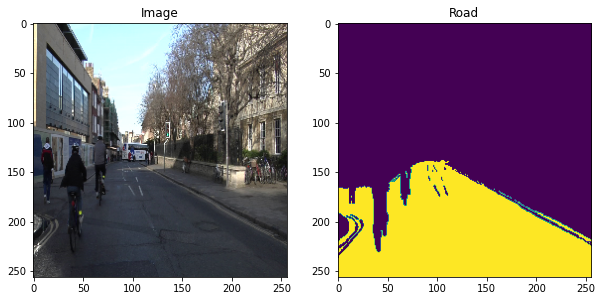

In [39]:
# snity check after train/val/test split
i = 1
plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.imshow(x_test[i])
plt.title('Image')
plt.subplot(1, 2, 2)
plt.imshow(y_test[i][:,:,13])
plt.title('Road')
plt.show()

In [40]:
from keras import backend as K

# implemets custom losses for experiments
def huber_weighted_loss(y_true, y_pred):
    """ Weighted huber loss"""
    threshold = 1
    error = y_true - (y_pred * class_weights)
    is_small_error = tf.abs(error) < threshold
    small_error_loss =  tf.square(error) / 2
    big_error_loss = threshold * (tf.abs(error) - (0.5 * threshold))
    return tf.where(is_small_error, small_error_loss, big_error_loss)

def weighted_CCE_loss(class_weights):
    """ Weighted crossentropy loss """
    def weighted_loss(y_true, y_pred):
        class_weights_tensor = tf.cast(class_weights, tf.float32)
        y_pred_weighted = y_pred * class_weights_tensor
        cce_loss = - K.sum(y_true * K.log(y_pred_weighted))
        return cce_loss
    return weighted_loss

In [41]:
# just do some check of data again before training model
x_train[0].min(), y_train[0].min(), x_train[0].max(), y_train[0].max()

(0.0, 0.0, 1.0, 1.0)

In [57]:
# build unet model for multiclass case

from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, ReLU
from keras.layers import Conv2DTranspose, BatchNormalization, Dropout, Lambda


KERNEL = kernel = tf.keras.initializers.HeNormal()

def multi_unet(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS, N_CLASSES):
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    # Encoder
    c1 = Conv2D(64, (3, 3), padding='same', kernel_initializer=KERNEL)(inputs)
    c1 = ReLU()(c1)
    c1 = BatchNormalization()(c1)
    c1 = Conv2D(64, (3, 3), padding='same', kernel_initializer=KERNEL)(c1)
    c1 = BatchNormalization()(c1)
    c1 = ReLU()(c1)
    p1 = MaxPooling2D((2, 2), strides=2)(c1)

    c2 = Conv2D(128, (3, 3), padding='same', kernel_initializer=KERNEL)(p1)
    c2 = ReLU()(c2)
    c2 = BatchNormalization()(c2)
    c2 = Conv2D(128, (3, 3), padding='same', kernel_initializer=KERNEL)(c2)
    c2 = BatchNormalization()(c2)
    c2 = ReLU()(c2)
    p2 = MaxPooling2D((2, 2), strides=2)(c2)
     
    c3 = Conv2D(256, (3, 3), padding='same', kernel_initializer=KERNEL)(p2)
    c3 = ReLU()(c3)
    c3 = BatchNormalization()(c3)
    c3 = Conv2D(256, (3, 3), padding='same', kernel_initializer=KERNEL)(c3)
    c3 = ReLU()(c3)
    c3 = BatchNormalization()(c3)
    p3 = MaxPooling2D((2, 2), strides=2)(c3)
     
    c4 = Conv2D(512, (3, 3), padding='same', kernel_initializer=KERNEL)(p3)
    c4 = ReLU()(c4)
    c4 = BatchNormalization()(c4)
    c4 = Conv2D(512, (3, 3), padding='same', kernel_initializer=KERNEL)(c4)
    c4 = ReLU()(c4)
    c4 = BatchNormalization()(c4)
    p4 = MaxPooling2D((2, 2), strides=2)(c4)
     
    c5 = Conv2D(1024, (3, 3), padding='same', kernel_initializer=KERNEL)(p4)
    c5 = ReLU()(c5)
    c5 = BatchNormalization()(c5)

    # Decoder
    u6 = Conv2DTranspose(512, (2, 2), strides=2, padding='same')(c5)
    u6 = tf.concat([c4, u6], axis=3)
    c6 = Conv2D(512, (3, 3), padding='same', kernel_initializer=KERNEL)(u6)
    c6 = ReLU()(c6)
    c6 = BatchNormalization()(c6)
    c6 = Conv2D(512, (3, 3), padding='same', kernel_initializer=KERNEL)(c6)
    c6 = ReLU()(c6)
    c6 = BatchNormalization()(c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=2, padding='same')(c6)
    u7 = tf.concat([c3, u7], axis=3)
    c7 = Conv2D(256, (3, 3), padding='same', kernel_initializer=KERNEL)(u7)
    c7 = ReLU()(c7)
    c7 = BatchNormalization()(c7)
    c7 = Conv2D(256, (3, 3), padding='same', kernel_initializer=KERNEL)(c7)
    c7 = ReLU()(c7)
    c7 = BatchNormalization()(c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=2, padding='same')(c7)
    u8 = tf.concat([u8, c2], axis=3)
    c8 = Conv2D(128, (3, 3), padding='same', kernel_initializer=KERNEL)(u8)
    c8 = ReLU()(c8)
    c8 = BatchNormalization()(c8)
    c8 = Conv2D(128, (3, 3), padding='same', kernel_initializer=KERNEL)(c8)
    c8 = ReLU()(c8)
    c8 = BatchNormalization()(c8)
    
    u9 = Conv2DTranspose(64, (2, 2), strides=2, padding='same')(c8)
    u9 = tf.concat([c1, u9], axis=3)
    c9 = Conv2D(64, (3, 3), padding='same', kernel_initializer=KERNEL)(u9)
    c9 = ReLU()(c9)
    c9 = BatchNormalization()(c9)
    c9 = Conv2D(64, (3, 3), padding='same', kernel_initializer=KERNEL)(c9)
    c9 = ReLU()(c9)
    c9 = BatchNormalization()(c9)

    # set outputs
    outputs = Conv2D(N_CLASSES, (1, 1), activation='softmax')(c9)
    model = Model(inputs=inputs, outputs=outputs)
    
    return model

In [46]:
# declare the model and compile it
model = multi_unet(
    IMG_HEIGHT=NEW_SIZE[0], IMG_WIDTH=NEW_SIZE[1], IMG_CHANNELS=3,  N_CLASSES=N_CLASSES
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=5e-4),
    loss=weighted_CCE_loss(class_weights),
    metrics=['accuracy']
)
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_54 (Conv2D)              (None, 256, 256, 64) 1792        input_4[0][0]                    
__________________________________________________________________________________________________
re_lu_51 (ReLU)                 (None, 256, 256, 64) 0           conv2d_54[0][0]                  
__________________________________________________________________________________________________
batch_normalization_51 (BatchNo (None, 256, 256, 64) 256         re_lu_51[0][0]                   
____________________________________________________________________________________________

In [47]:
# And fun comes..!

EPOCHS = 100
BATCH_SIZE = 8  # according to the original paper

history = model.fit(
    np.array(x_train), np.array(y_train),
    validation_data=(np.array(x_val), np.array(y_val)),          
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    verbose=2)

Epoch 1/100
10/10 - 8s - loss: 7852.8623 - accuracy: 0.4783 - val_loss: 2814153.2500 - val_accuracy: 0.2435
Epoch 2/100
10/10 - 2s - loss: -6.2754e+05 - accuracy: 0.7964 - val_loss: nan - val_accuracy: 0.3829
Epoch 3/100
10/10 - 2s - loss: -7.6811e+05 - accuracy: 0.8536 - val_loss: nan - val_accuracy: 0.2625
Epoch 4/100
10/10 - 2s - loss: -8.2343e+05 - accuracy: 0.8711 - val_loss: nan - val_accuracy: 0.2712
Epoch 5/100
10/10 - 2s - loss: -8.5848e+05 - accuracy: 0.8860 - val_loss: nan - val_accuracy: 0.4823
Epoch 6/100
10/10 - 2s - loss: -8.8163e+05 - accuracy: 0.8962 - val_loss: 3327978.0000 - val_accuracy: 0.2852
Epoch 7/100
10/10 - 2s - loss: -8.9603e+05 - accuracy: 0.9014 - val_loss: 3317550.2500 - val_accuracy: 0.2963
Epoch 8/100
10/10 - 2s - loss: -9.1037e+05 - accuracy: 0.9089 - val_loss: 2811121.2500 - val_accuracy: 0.2520
Epoch 9/100
10/10 - 2s - loss: -9.2751e+05 - accuracy: 0.9183 - val_loss: 2858143.2500 - val_accuracy: 0.3072
Epoch 10/100
10/10 - 2s - loss: -9.3388e+05 - ac

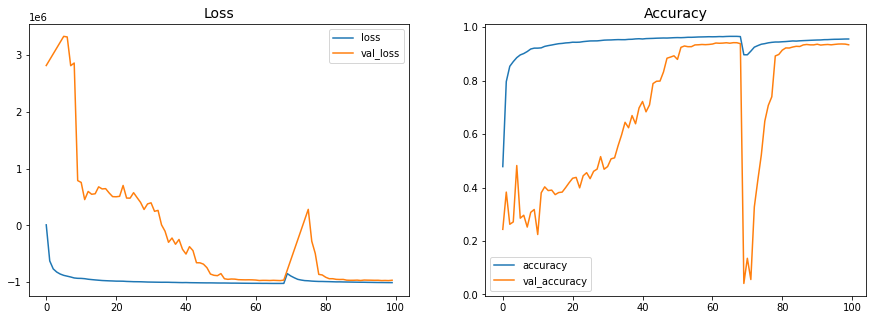

In [48]:
import seaborn as sns

loss = history.history['loss']
accuracy = history.history['accuracy']
val_loss = history.history['val_loss']
val_accuracy = history.history['val_accuracy']
epoch = range(0, EPOCHS)

plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.lineplot(epoch, loss)
sns.lineplot(epoch, val_loss)
plt.title('Loss', size=14)
plt.legend(['loss', 'val_loss'])
plt.subplot(1,2,2)
sns.lineplot(epoch, accuracy)
sns.lineplot(epoch, val_accuracy)
plt.title('Accuracy', size=14)
plt.legend(['accuracy', 'val_accuracy'])
plt.show()

In [49]:
# make predictions

prediction = model.predict(np.array(x_test))

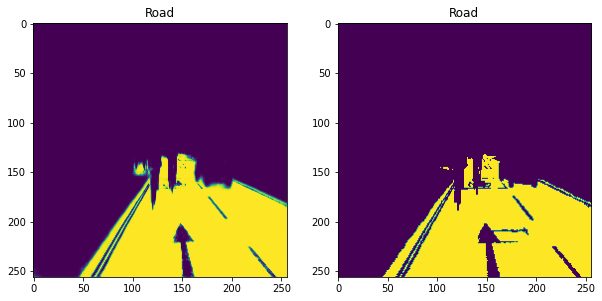

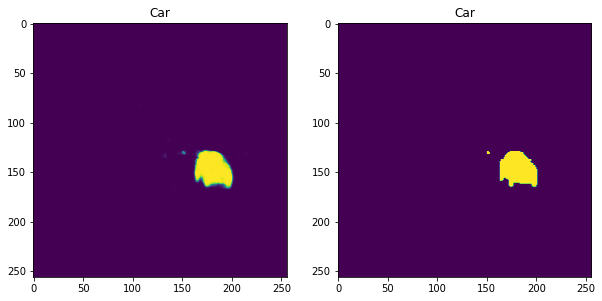

In [52]:
# look at some predictions and ground truth
plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.imshow(prediction[3][:,:,13])
plt.title('Road')
plt.subplot(1, 2, 2)
plt.imshow(y_test[3][:,:,13])
plt.title('Road')
plt.show()

plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Car')
plt.imshow(prediction[3][:,:,4]) 
plt.subplot(1, 2, 2)
plt.imshow(y_test[3][:,:,4])
plt.title('Car')
plt.show()

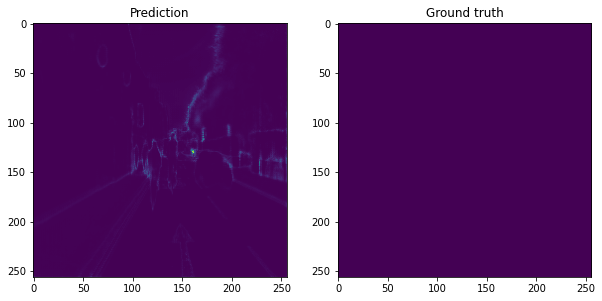

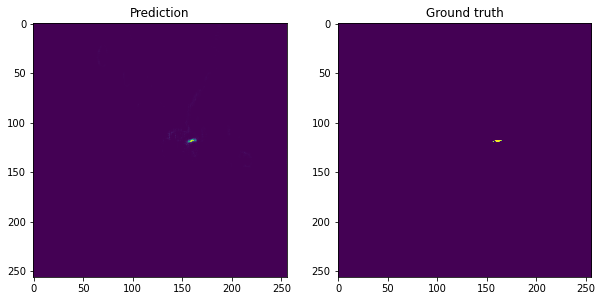

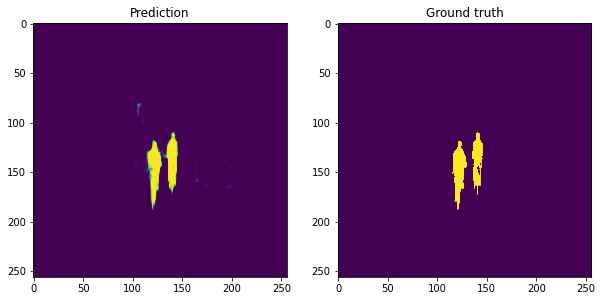

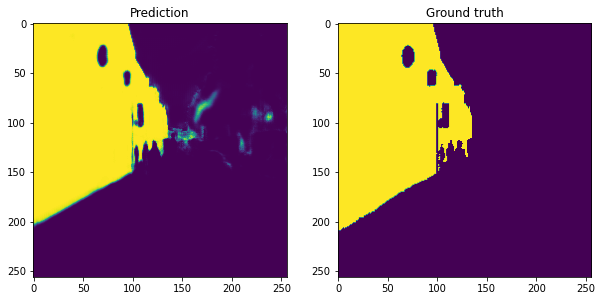

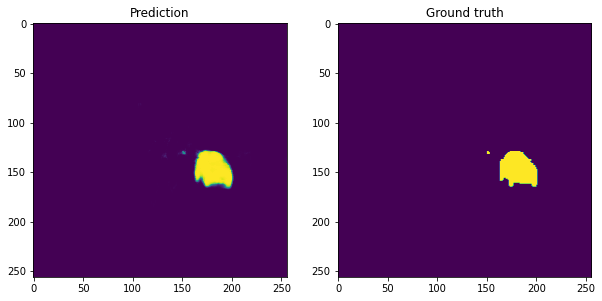

...

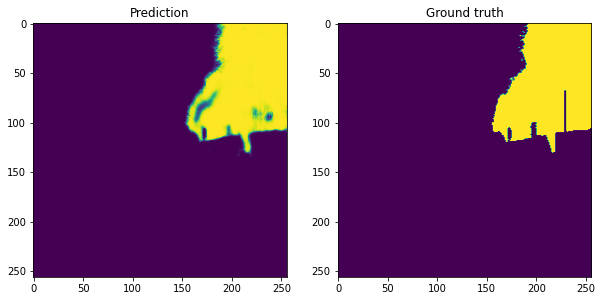

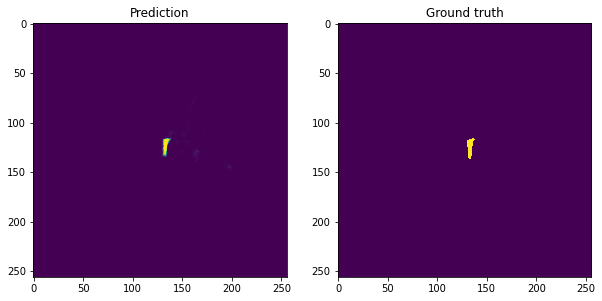

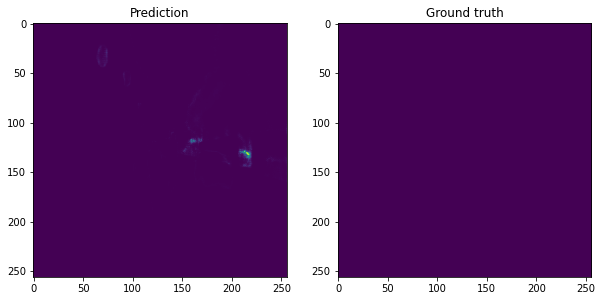

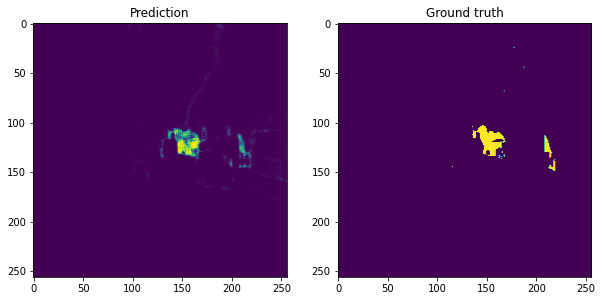

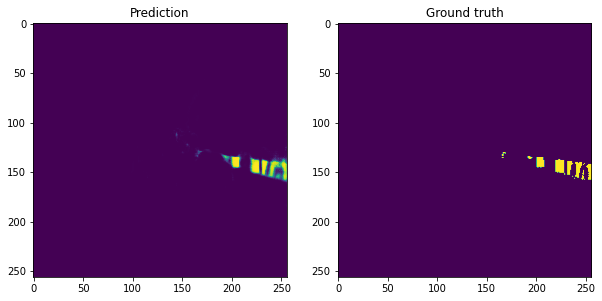

In [56]:
# look for all predictions and ground truth from one predicted picture

for i in range(N_CLASSES):
    plt.subplot(1,2,1)
    plt.imshow(prediction[3][:,:,i])
    plt.title('Prediction')
    plt.subplot(1,2,2)
    plt.imshow(y_test[3][:,:,i])
    plt.title('Ground truth')
    plt.show()

In [ ]:
# Try vanilla categorical crossentropy without weithting our classes!

model = multi_unet(IMG_HEIGHT=NEW_SIZE[0], 
                   IMG_WIDTH=NEW_SIZE[1], 
                   IMG_CHANNELS=3,  
                   N_CLASSES=N_CLASSES)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=5e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
EPOCHS = 100
BATCH_SIZE = 8
history = model.fit(
    np.array(x_train), np.array(y_train),
    validation_data=(np.array(x_val), np.array(y_val)),          
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    verbose=0)

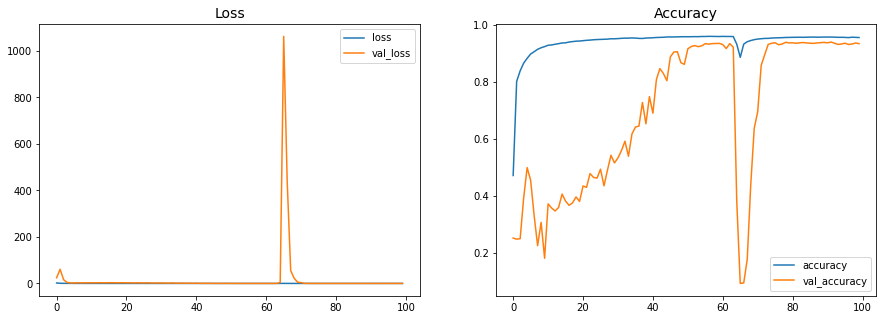

In [59]:
loss = history.history['loss']
accuracy = history.history['accuracy']
val_loss = history.history['val_loss']
val_accuracy = history.history['val_accuracy']
epoch = range(0, EPOCHS)

plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.lineplot(epoch, loss)
sns.lineplot(epoch, val_loss)
plt.title('Loss', size=14)
plt.legend(['loss', 'val_loss'])
plt.subplot(1,2,2)
sns.lineplot(epoch, accuracy)
sns.lineplot(epoch, val_accuracy)
plt.title('Accuracy', size=14)
plt.legend(['accuracy', 'val_accuracy'])
plt.show()

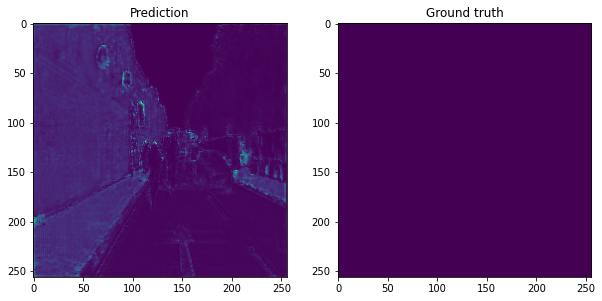

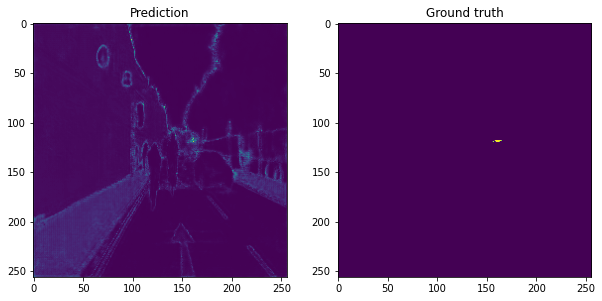

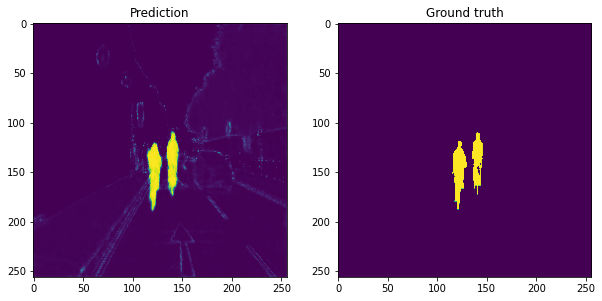

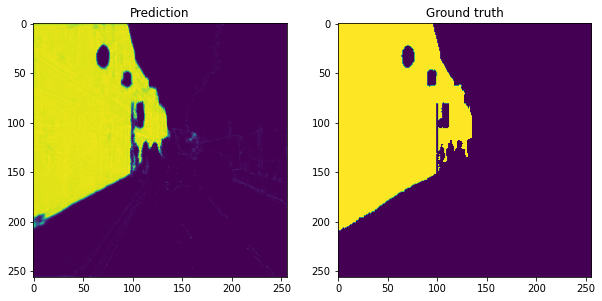

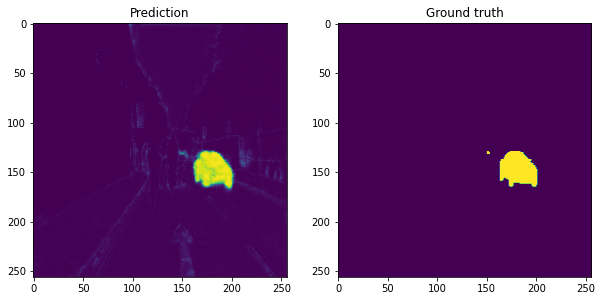

...

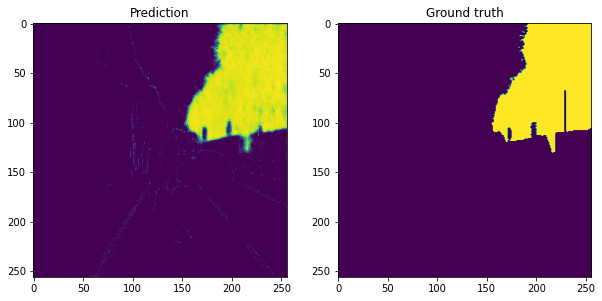

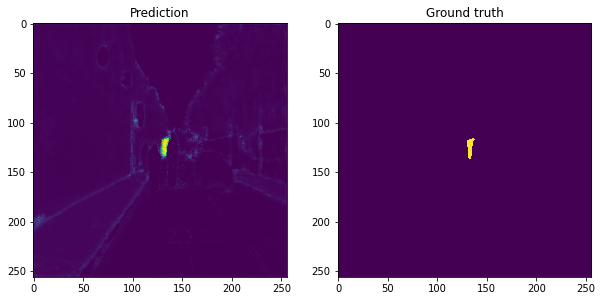

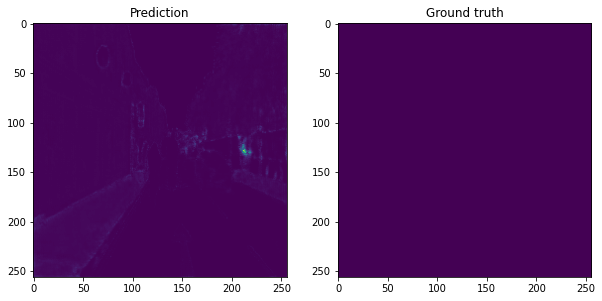

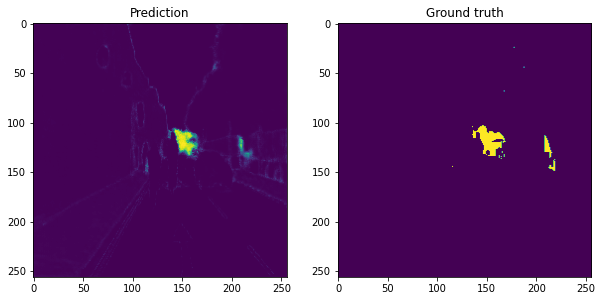

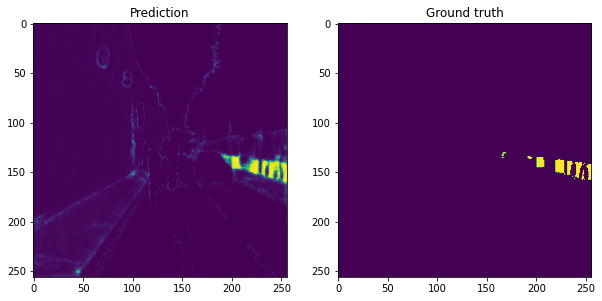

In [60]:
# make predictions
prediction = model.predict(np.array(x_test))

# look for all predictions and ground truth from one predicted picture
for i in range(N_CLASSES):
    plt.subplot(1,2,1)
    plt.imshow(prediction[3][:,:,i])
    plt.title('Prediction')
    plt.subplot(1,2,2)
    plt.imshow(y_test[3][:,:,i])
    plt.title('Ground truth')
    plt.show()

In [61]:
# As we can see, weiting classes was important and we got better results with it!

# OK! Let's train another architecture: SegNet!

###**SEGNET**

In [62]:
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import ReLU, Flatten, Reshape
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.models import Model


KERNEL = tf.keras.initializers.HeNormal()

def segnet(input_shape, n_classes):
    inputs = Input(shape=input_shape)
    # Encoder
    #x, p_1 = encoder(inputs, 2, 64, 3, (2, 2), 2)(inputs)
    x = Conv2D(64, 3, padding='same', kernel_initializer=KERNEL)(inputs)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(64, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = MaxPooling2D((2, 2), strides=2)(x)
    p_1 = x
    #x, p_2 = encoder(inputs, 2, 128, 3, (2, 2), 2)(inputs)
    x = Conv2D(128, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(128, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = MaxPooling2D((2, 2), strides=2)(x)
    p_2 = x
    #x, p_3 = encoder(inputs, 2, 256, 3, (2, 2), 2)(inputs)
    x = Conv2D(256, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(256, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(256, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = MaxPooling2D((2, 2), strides=2)(x)
    p_3 = x
    #x, p_4 = encoder(inputs, 2, 512, 3, (2, 2), 2)(inputs)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = MaxPooling2D((2, 2), strides=2)(x)
    p_4 = x

    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = MaxPooling2D((2, 2), strides=2)(x)
    p_5 = x
    
    # Decoder
    o = tf.concat([x, p_5], axis=3)
    x = UpSampling2D(2, interpolation='nearest')(o)
    #x = tf.keras.layers.Conv2DTranspose(512, 2, strides=2, use_bias=False, padding='same')(o)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    o = tf.concat([x, p_4], axis=3)
    x = UpSampling2D(2, interpolation='nearest')(o)
    #x = tf.keras.layers.Conv2DTranspose(512, 2, strides=2, use_bias=False, padding='same')(o)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(512, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    
    o = tf.concat([x, p_3], axis=3)
    x = UpSampling2D(2, interpolation='nearest')(o)
    #x = tf.keras.layers.Conv2DTranspose(256, 2, strides=2, use_bias=False, padding='same')(o)
    x = Conv2D(256, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(256, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(256, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    o = tf.concat([x, p_2], axis=3)
    x = UpSampling2D(2, interpolation='nearest')(o)
    #x = tf.keras.layers.Conv2DTranspose(128, 2, strides=2, use_bias=False, padding='same')(o)
    x = Conv2D(128, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(128, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    o = tf.concat([x, p_1], axis=3)
    x = UpSampling2D(2, interpolation='nearest')(o)
    #x = tf.keras.layers.Conv2DTranspose(64, 2, strides=2, use_bias=False, padding='same')(o)
    x = Conv2D(64, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(64, 3, padding='same', kernel_initializer=KERNEL)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    outputs = Conv2D(n_classes, 1, activation='softmax')(x)
    model = Model(inputs=inputs, outputs=outputs)

    return model

In [63]:
model_segnet= segnet(
    input_shape=(NEW_SIZE[0], NEW_SIZE[1], 3), 
    n_classes=N_CLASSES
)
model_segnet.summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_90 (Conv2D)              (None, 256, 256, 64) 1792        input_6[0][0]                    
__________________________________________________________________________________________________
batch_normalization_85 (BatchNo (None, 256, 256, 64) 256         conv2d_90[0][0]                  
__________________________________________________________________________________________________
re_lu_85 (ReLU)                 (None, 256, 256, 64) 0           batch_normalization_85[0][0]     
____________________________________________________________________________________________

In [66]:
# use the custom weighted crossentropy loss which has been initialized beforehand
model_segnet.compile( 
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
    loss=weighted_CCE_loss(class_weights), 
    metrics=['accuracy'], 
)
EPOCHS = 100
BATCH_SIZE = 8
history = model_segnet.fit(np.array(x_train), np.array(y_train),
                           validation_data=(np.array(x_val), np.array(y_val)),     
                           epochs=EPOCHS,
                           batch_size=BATCH_SIZE,
                           verbose=2)

Epoch 1/100
10/10 - 9s - loss: 215962.1719 - accuracy: 0.3573 - val_loss: 1664404.5000 - val_accuracy: 0.1629
Epoch 2/100
10/10 - 3s - loss: -3.6826e+05 - accuracy: 0.7613 - val_loss: 1660644.8750 - val_accuracy: 0.3763
Epoch 3/100
10/10 - 3s - loss: -5.5510e+05 - accuracy: 0.8320 - val_loss: 1082271.3750 - val_accuracy: 0.4836
Epoch 4/100
10/10 - 3s - loss: -6.4718e+05 - accuracy: 0.8584 - val_loss: 211604.3438 - val_accuracy: 0.5104
Epoch 5/100
10/10 - 3s - loss: -7.0657e+05 - accuracy: 0.8785 - val_loss: 173038.2500 - val_accuracy: 0.5246
Epoch 6/100
10/10 - 3s - loss: -7.4452e+05 - accuracy: 0.8914 - val_loss: 246240.9688 - val_accuracy: 0.4611
Epoch 7/100
10/10 - 3s - loss: -7.7206e+05 - accuracy: 0.9012 - val_loss: 320761.8125 - val_accuracy: 0.4380
Epoch 8/100
10/10 - 3s - loss: -7.9334e+05 - accuracy: 0.9069 - val_loss: 313273.3750 - val_accuracy: 0.4438
Epoch 9/100
10/10 - 3s - loss: -8.1338e+05 - accuracy: 0.9127 - val_loss: 367785.3750 - val_accuracy: 0.4300
Epoch 10/100
10/

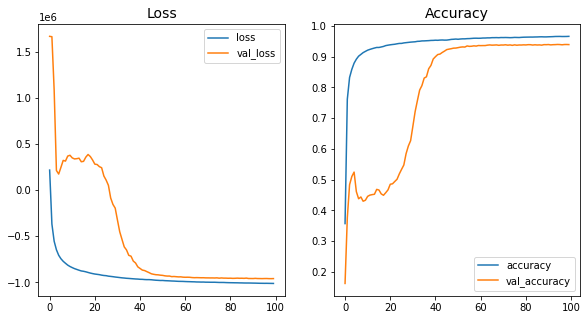

In [67]:
loss = history.history['loss']
accuracy = history.history['accuracy']
val_loss = history.history['val_loss']
val_accuracy = history.history['val_accuracy']
epoch = range(0, EPOCHS)

plt.figure(figsize=(15,5))

plt.subplot(1,3,1)
sns.lineplot(epoch, loss)
sns.lineplot(epoch, val_loss)
plt.title('Loss', size=14)
plt.legend(['loss', 'val_loss'])

plt.subplot(1,3,2)
sns.lineplot(epoch, accuracy)
sns.lineplot(epoch, val_accuracy)
plt.title('Accuracy', size=14)
plt.legend(['accuracy', 'val_accuracy'])

In [68]:
# save weights of the model
model_segnet.save_weights('/content/segnet_weights.h5')

from google.colab import files
files.download('/content/segnet_weights.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [69]:
# make predictions

prediction = model_segnet.predict(np.array(x_test))

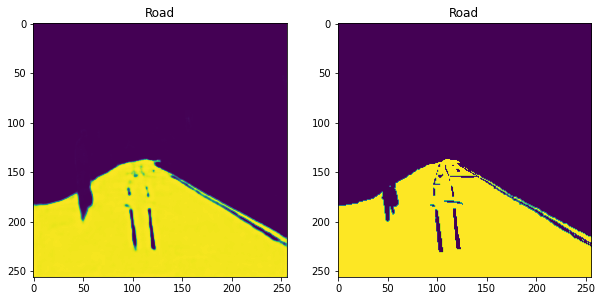

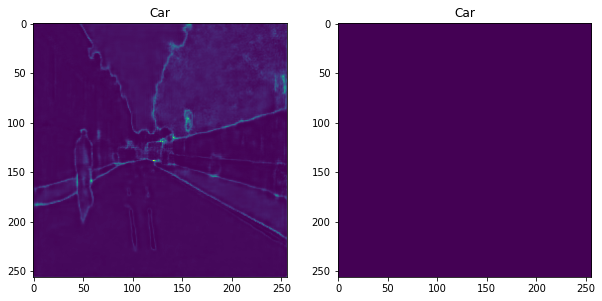

In [72]:
plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.imshow(prediction[0][:,:,13]) 
plt.title('Road')
plt.subplot(1, 2, 2)
plt.imshow(y_test[0][:,:,13])
plt.title('Road')
plt.show()

plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('Car')
plt.imshow(prediction[0][:,:,5]) 
plt.subplot(1, 2, 2)
plt.imshow(y_test[0][:,:,5])
plt.title('Car')
plt.show()

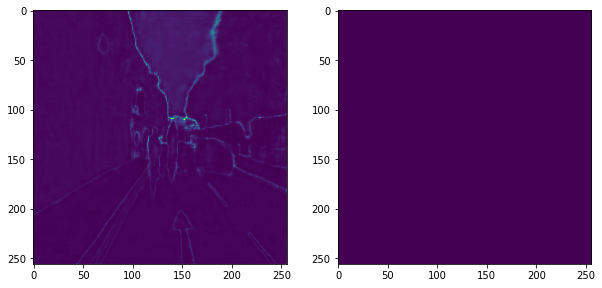

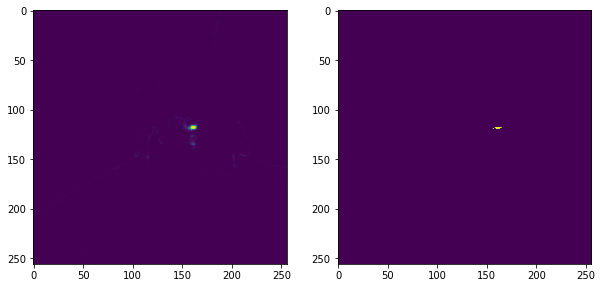

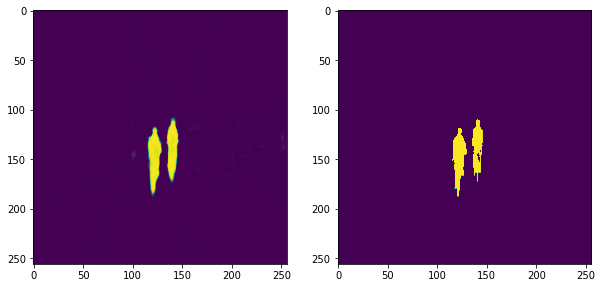

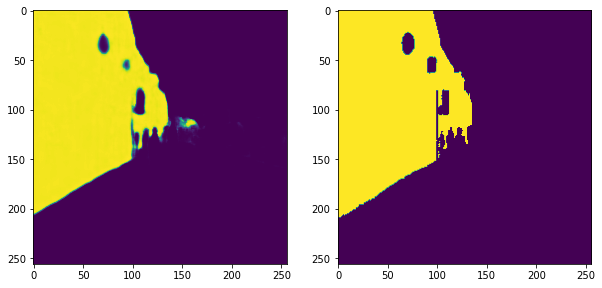

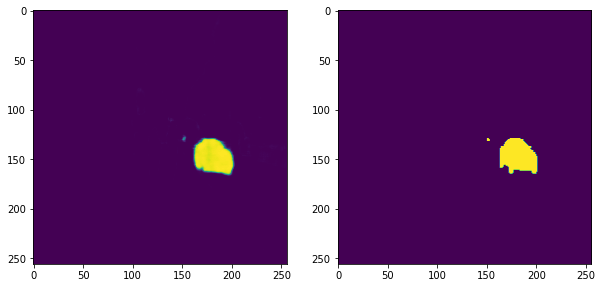

...

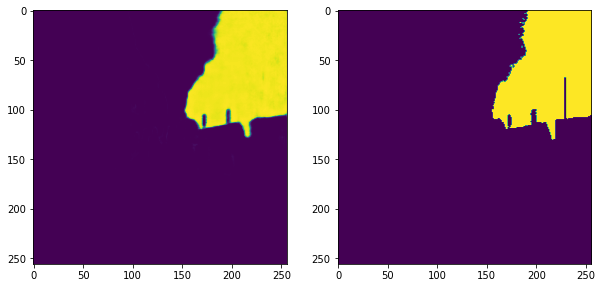

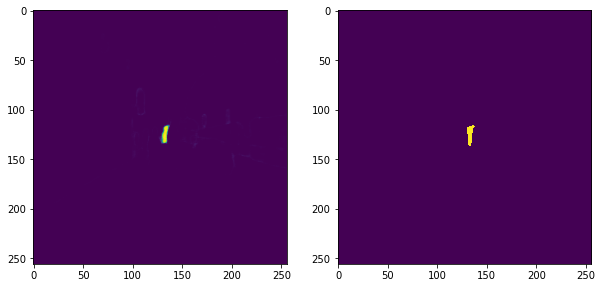

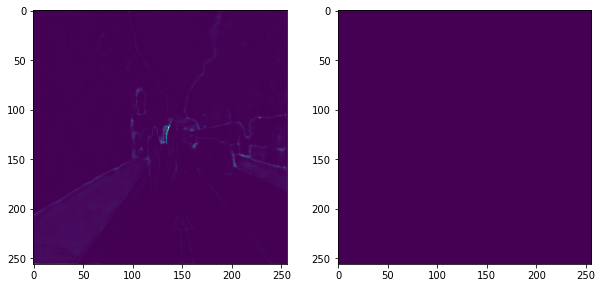

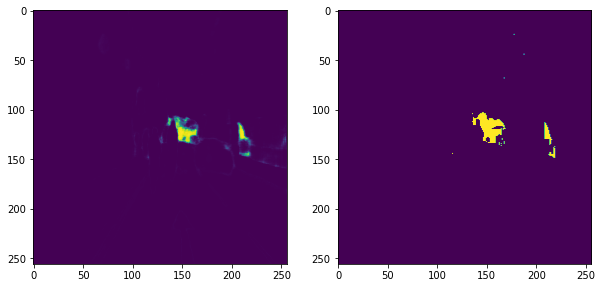

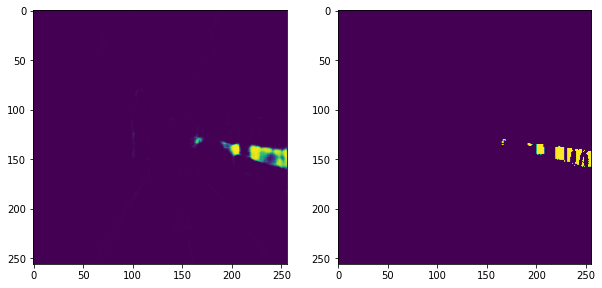

In [73]:
for i in range(N_CLASSES):
    plt.subplot(1,2,1)
    plt.imshow(prediction[3][:,:,i])
    plt.subplot(1,2,2)
    plt.imshow(y_test[3][:,:,i])
    plt.show()

In [ ]:
# load weights to the model

files.upload()
model_segnet.load_weights('/content/segnet_weights.h5')

In [74]:
# get list of color codes 

color_codes_list = [color_codes[i] for i in color_codes.keys()]

In [76]:
# make predictions for x_test

predictions_segnet = model_segnet.predict(np.array(x_test))
predictions_unet = model.predict(np.array(x_test))

In [79]:
def get_rgb_image(prediction, n_classes, color_codes):
    """Returns RGB image from predicted segmentation map"""
    output_height = prediction.shape[0]
    output_width = prediction.shape[1]
    seg_img = np.zeros((output_height, output_width, 3))
    for c in range(n_classes):
        seg_img[:, :, 0] += ((prediction[:, :, c])*(color_codes[c][0])).astype('uint8')
        seg_img[:, :, 1] += ((prediction[:, :, c])*(color_codes[c][1])).astype('uint8')
        seg_img[:, :, 2] += ((prediction[:, :, c])*(color_codes[c][2])).astype('uint8')
    return seg_img / 255.0

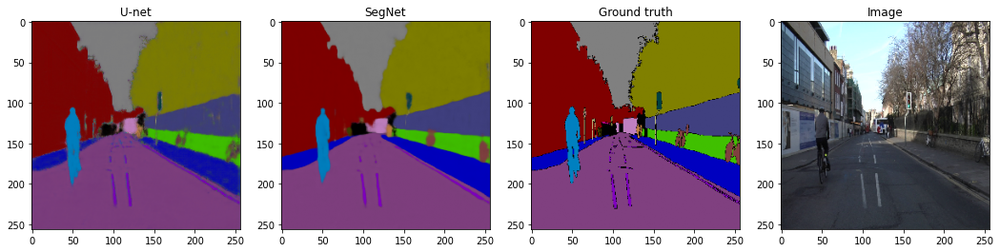

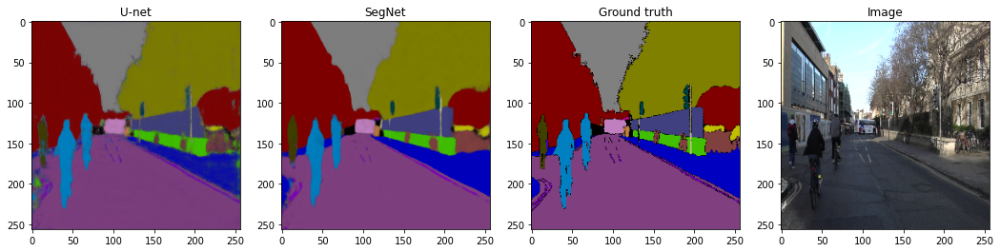

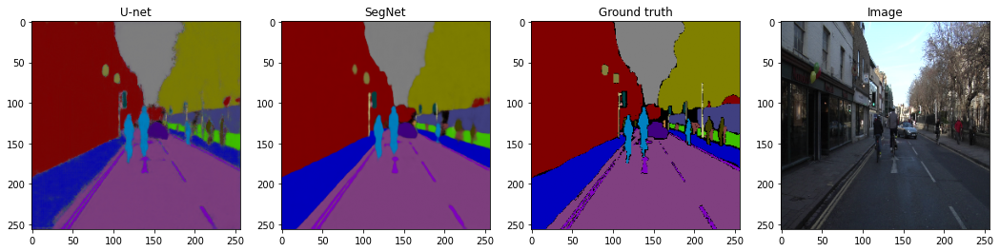

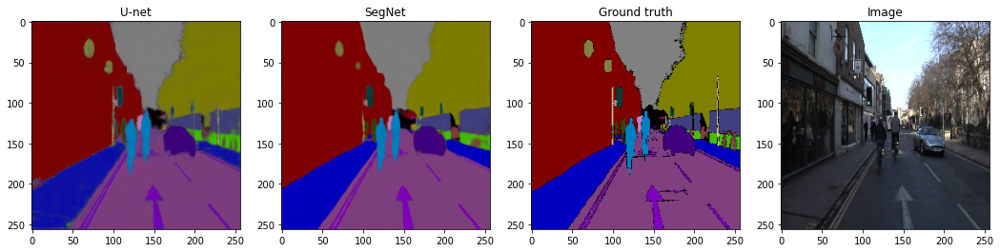

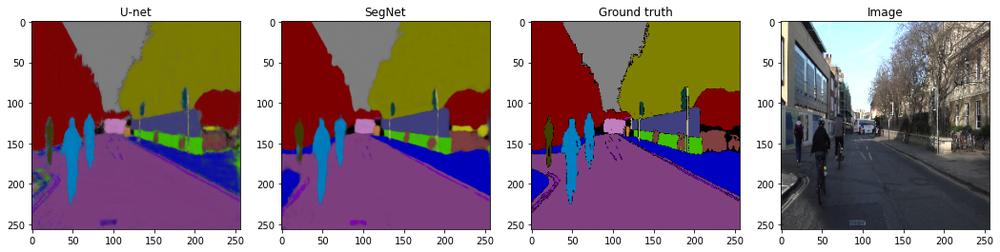

In [106]:
# Visualize U-net, SegNet prediction and ground truth

for i in range(len(x_test)):
    plt.figure(figsize=(18, 6))
    plt.subplot(1,4,1)
    plt.imshow(get_rgb_image(predictions_unet[i], N_CLASSES, color_codes_list))
    plt.title('U-net')
    plt.subplot(1,4,2)
    plt.imshow(get_rgb_image(predictions_segnet[i], N_CLASSES, color_codes_list))
    plt.title('SegNet')
    plt.subplot(1,4,3)
    plt.imshow(get_rgb_image(y_test[i], N_CLASSES, color_codes_list))
    plt.title('Ground truth')
    plt.subplot(1,4,4)
    plt.imshow(x_test[i])
    plt.title('Image')
    plt.show()

## **Useless experiment just for fun**

In [91]:
files.upload()

Saving for_segm1.jpg to for_segm1.jpg
Saving for_segm2.jpg to for_segm2.jpg
Saving for_segm3.jpg to for_segm3.jpg
Saving for_segm4.jpg to for_segm4.jpg


{'for_segm1.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x06\x04\x05\x06\x05\x04\x06\x06\x05\x06\x07\x07\x06\x08\n\x10\n\n\t\t\n\x14\x0e\x0f\x0c\x10\x17\x14\x18\x18\x17\x14\x16\x16\x1a\x1d%\x1f\x1a\x1b#\x1c\x16\x16 , #&\')*)\x19\x1f-0-(0%()(\xff\xdb\x00C\x01\x07\x07\x07\n\x08\n\x13\n\n\x13(\x1a\x16\x1a((((((((((((((((((((((((((((((((((((((((((((((((((\xff\xc2\x00\x11\x08\x03 \x04\xb0\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1b\x00\x00\x01\x05\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x04\x01\x02\x03\x05\x06\x00\x07\xff\xc4\x00\x1a\x01\x01\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\xff\xda\x00\x0c\x03\x01\x00\x02\x10\x03\x10\x00\x00\x01\xc5\xa3\xd2\xe6Nw[#^\xd4r*\x11#\xd2^\xb4\xab\xb4\x10\xc0\xccZ\xf8\xe6d\x92\x8e@\xa4\xe3M\x0c\xae\x927\x89$2\xd4p\x91\x04\x10\xf7GQ\xe8\xf3:l\xdb\x1eN\xce\x92TXo*\x13\'8k\\\xba\x94\x10\x08\x0f^w\x11\xd5\xb9m\x98/\x05\xb8g\xa3\xc5 u\x16\x12\xda4

In [92]:
path_list = ['/content/for_segm1.jpg', 
             '/content/for_segm2.jpg', 
             '/content/for_segm3.jpg', 
             '/content/for_segm4.jpg']

In [93]:
def photo_normalizer(path, new_size=NEW_SIZE):  
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, new_size) 
    img = img / 255.0
    return img

In [94]:
photos = [photo_normalizer(path=pth) for pth in path_list]

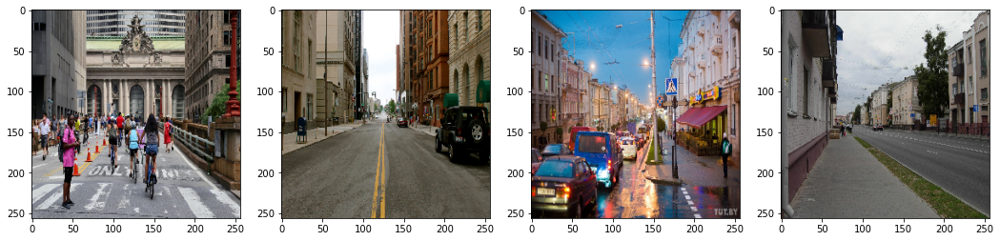

In [95]:
plt.figure(figsize=(18,10))
for i in range(len(photos)):
    plt.subplot(1, len(photos), i+1)
    plt.imshow(photos[i])

In [96]:
predict_unet = model.predict(np.array(photos))
predict_segnet = model_segnet.predict(np.array(photos))

In [98]:
segmented_unet = [get_rgb_image(pred, N_CLASSES, color_codes_list) for pred in predict_unet]
segmented_segnet = [get_rgb_image(pred, N_CLASSES, color_codes_list) for pred in predict_segnet]

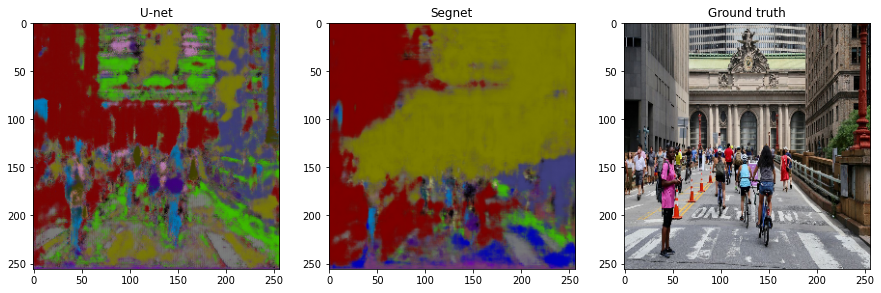

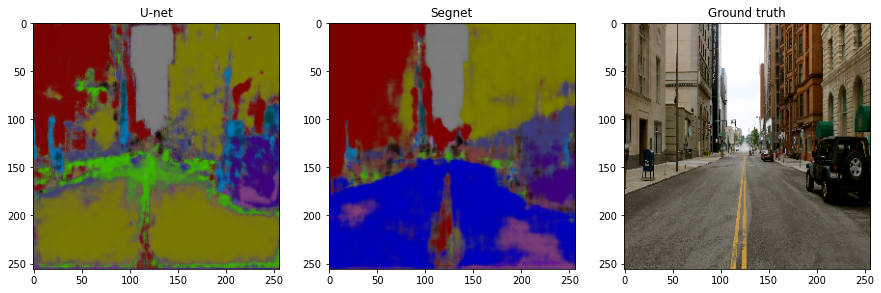

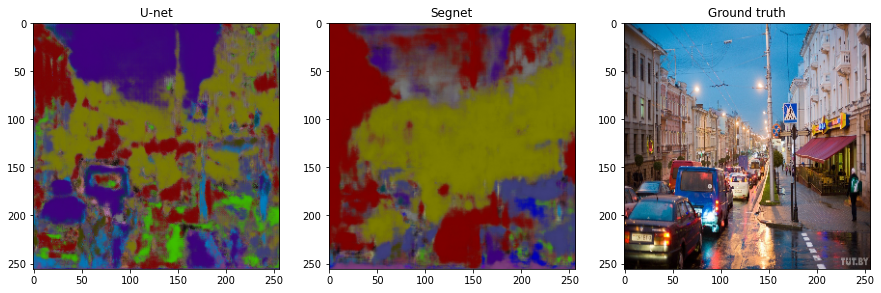

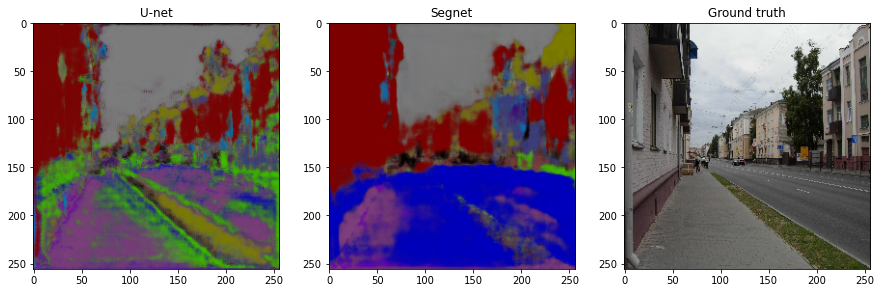

In [101]:
# Visualize out prediction and ground truth
for i in range(len(photos)):
    plt.figure(figsize=(15, 6))
    plt.subplot(1,3,1)
    plt.imshow(segmented_unet[i])
    plt.title('U-net')
    plt.subplot(1,3,2)
    plt.imshow(segmented_segnet[i])
    plt.title('Segnet')
    plt.subplot(1,3,3)
    plt.imshow(photos[i])
    plt.title('Ground truth')
    plt.show()

# **Our predictions look like the art! =)**